In [1]:
%load_ext autoreload
%autoreload 2

import cv2
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import glob
import h5py

import sys
sys.path.append('../../src')
from utils import smooth_curve
from viz import show_images
from PlumeDataset import plume_dataset
from AutoAlign import align_plumes
from Velocity import VelocityCalculator
from PlumeMetrics import PlumeMetrics
from HorizontalLineProfileAnalyzer import HorizontalLineProfileAnalyzer

def visualize_corners(image: np.ndarray, coordinates: np.ndarray, color='k', marker_size=50):
    """
    Visualize corners on the given image using matplotlib, plotting only dots.
    
    Args:
    - image: NumPy array of shape (H, W, C) representing the image
    - coordinates: NumPy array of shape (N, 2) where N is the number of corners,
                   each row contains [x, y] coordinates
    - color: Color of the corner markers (default: 'r' for red)
    - marker_size: Size of the corner markers
    
    Returns:
    - matplotlib Figure object
    """
    fig, ax = plt.subplots()
    ax.imshow(image)
    ax.scatter(coordinates[:, 0], coordinates[:, 1], c=color, s=marker_size, marker='+')
    ax.set_xticks([])
    ax.set_yticks([])

imgs = []


def analyze_function(P, V, plumes, index, viz_index, plume_name, 
                     align_parms={'align':False, 'coords':None, 'coords_standard':None}):
    # plumes = plumes[x_range[0]:x_range[1]]

    # align plumes
    if align_parms['align']:
        if align_parms['coords'] is None or align_parms['coords_standard'] is None:
            raise ValueError('Please provide the coordinates for alignment')
        else:
            plumes = align_plumes(plumes, align_parms['coords'], align_parms['coords_standard'])

    show_images(plumes[index][viz_index], img_per_row=16, img_height=1, title=plume_name)
    plt.show()

    areas, coords, labeled_images = P.calculate_area_for_plumes(plumes, return_format='dataframe')
    df_area = P.to_df(areas)
    print(plumes[index][viz_index].shape, areas[index][viz_index].shape, coords[index][viz_index].shape, labeled_images[index][viz_index].shape)
    P.viz_blob_plume(plumes[index][viz_index], areas[index][viz_index], coords[index][viz_index], labeled_images[index][viz_index], title=f'{plume_name}-Area')

    plume_positions, plume_distances, plume_velocities = V.calculate_distance_area_for_plumes(plumes)
    df_velocity = V.to_df(plume_positions, plume_distances, plume_velocities)
    print(plumes[index][viz_index].shape, plume_positions[index][viz_index].shape, plume_distances[index][viz_index].shape, plume_velocities[index][viz_index].shape)
    V.visualize_plume_positions(plumes[index][viz_index], plume_positions[index][viz_index], label_time=False, title=f'{plume_name}-plume position')

    df = pd.concat([df_velocity, df_area], axis=1)
    return df

# analysis frame parameters
start_position = (30, (51+208)//2) # start position of plume  (x, y)
position_range = (30, 376) # x position range
threshold = 20
time_interval = 500e-9  # 500ns

# visualize parameters
index = 5
# x_range = (8, 82) # x_range of frames to visualize
viz_index = list(np.arange(0, 32, 1))

P = PlumeMetrics(time_interval, start_position, position_range, threshold=threshold)
V = VelocityCalculator(time_interval, position_range, start_position, threshold=threshold)

TypeError: PlumeMetrics.__init__() missing 1 required positional argument: 'threshold'

## YG052

['1-SrRuO3', '1-SrRuO3_Pre']


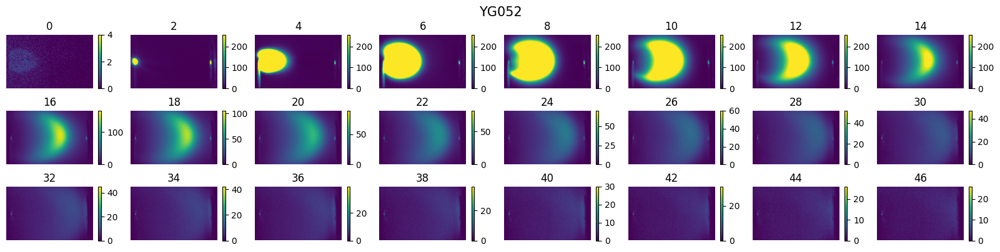

In [ ]:
file = '../../datasets/YG052_YichenGuo_06142024.h5'

plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
keys = plume_ds.dataset_names()
print(keys)

labels = list(np.arange(0, 48, 2))
ds_name = file.split('/')[-1].split('_')[0]
plumes = plume_ds.load_plumes('1-SrRuO3')
show_images(plumes[5][labels], labels=labels, img_per_row=8, img_height=1, title=ds_name, show_colorbar=True)
plt.show()

In [2]:
frame_view_YG052 = plume_ds.load_plumes('1-SrRuO3_Pre')[1][1]
coords_YG052 = np.array([[19,52], [21,215], [396,46], [394,320]])
px.imshow(frame_view_YG052)
# visualize_corners(frame_view_YG052, coords_YG052, color='k', marker_size=50)

NameError: name 'plume_ds' is not defined

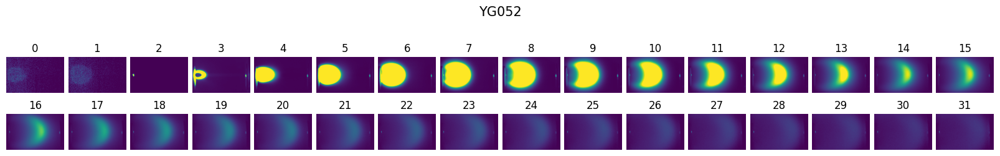

100%|██████████| 187/187 [01:03<00:00,  2.96it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


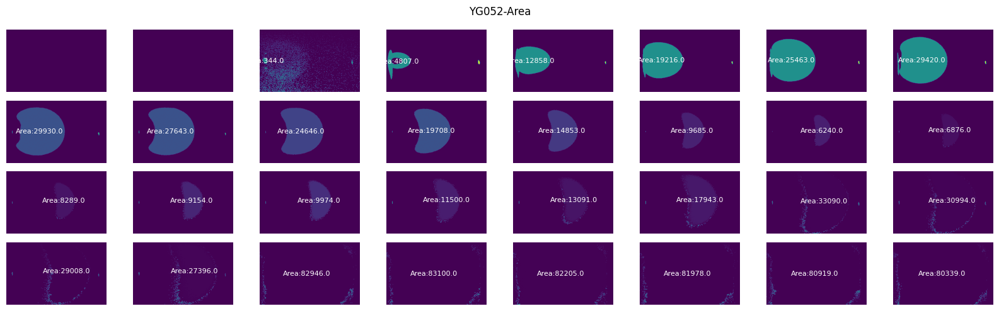

100%|██████████| 187/187 [00:16<00:00, 11.04it/s]


(32, 250, 400) (32, 2) (32,) (32,)


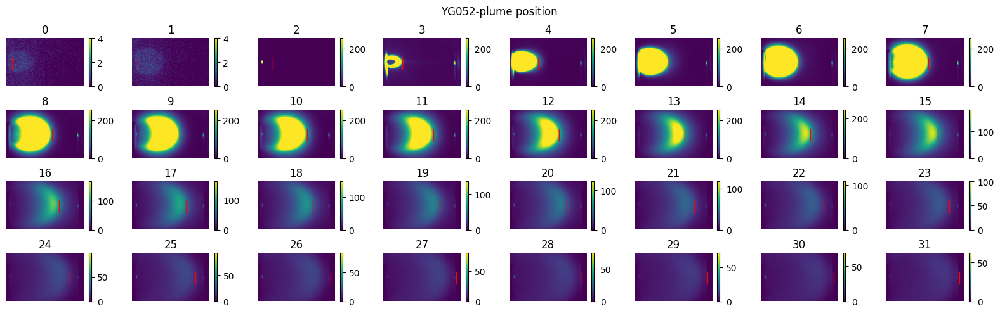

In [4]:
df_YG052 = analyze_function(P, V, plumes, threshold, index, viz_index, ds_name, align_parms={'align':False, 'coords':coords_YG052, 'coords_standard':coords_YG052})
df_YG052['Growth'] = ds_name
df_YG052.to_csv('../../datasets/SRO_plume_metrics/YG052_metrics.csv')

## YG053

['1-SrRuO3', '1-SrRuO3_Pre']


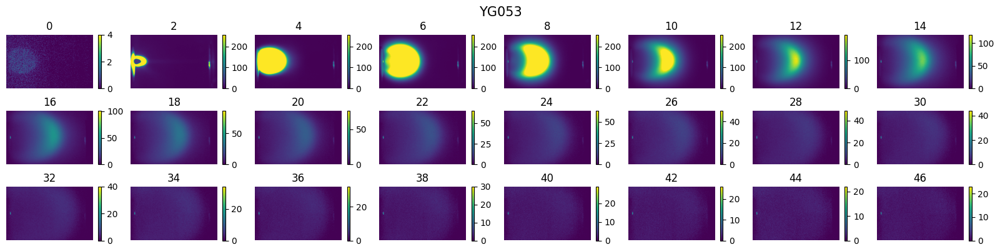

In [5]:
file = '../../datasets/YG053_YichenGuo_06172024.h5'

plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
keys = plume_ds.dataset_names()
print(keys)

labels = list(np.arange(0, 48, 2))
ds_name = file.split('/')[-1].split('_')[0]
plumes = plume_ds.load_plumes('1-SrRuO3')
show_images(plumes[5][labels], labels=labels, img_per_row=8, img_height=1, title=ds_name, show_colorbar=True)
plt.show()

In [6]:
frame_view_YG0053 = plume_ds.load_plumes('1-SrRuO3_Pre')[1][1]
coords_YG053 = np.array([[14,50], [16,214], [359,44], [361,229]])
px.imshow(frame_view_YG0053)

In [7]:
df_YG0053 = analyze_function(P, V, plumes, threshold, index, viz_index, ds_name, align_parms={'align':False, 'coords':coords_YG0053, 'coords_standard':coords_YG0053})
df_YG0053['Growth'] = ds_name
df_YG0053.to_csv('../../datasets/SRO_plume_metrics/YG0053_metrics.csv')

NameError: name 'coords_YG0053' is not defined

## YG054

['1-SrRuO3', '1-SrRuO3_Pre']


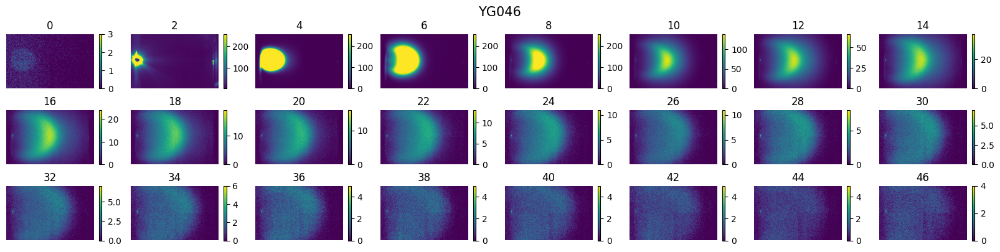

In [ ]:
file = '../../datasets/YG046_YichenGuo_05162024.h5'

plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
keys = plume_ds.dataset_names()
print(keys)

labels = list(np.arange(0, 48, 2))
ds_name = file.split('/')[-1].split('_')[0]
plumes = plume_ds.load_plumes('1-SrRuO3')
show_images(plumes[5][labels], labels=labels, img_per_row=8, img_height=1, title=ds_name, show_colorbar=True)
plt.show()

In [ ]:
frame_view_YG054 = plume_ds.load_plumes('1-SrRuO3_Pre')[1][1]
coords_YG054 = np.array([[14,55], [15,217], [357,48], [360,234]])
px.imshow(frame_view_YG054)

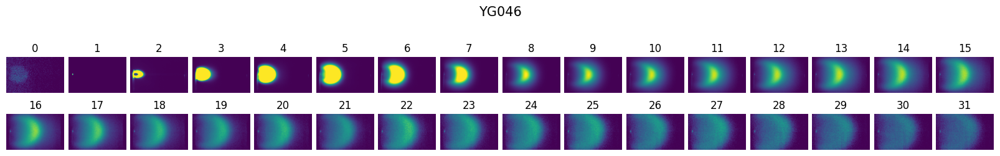

100%|██████████| 125/125 [00:32<00:00,  3.87it/s]


In [ ]:
df_YG054 = analyze_function(P, V, plumes, threshold, index, viz_index, ds_name, align_parms={'align':False, 'coords':coords_YG054, 'coords_standard':coords_YG054})
df_YG054['Growth'] = ds_name
df_YG054.to_csv('../../datasets/SRO_plume_metrics/YG054_metrics.csv')

## YG055

['1-SrRuO3', '1-SrRuO3_Pre']


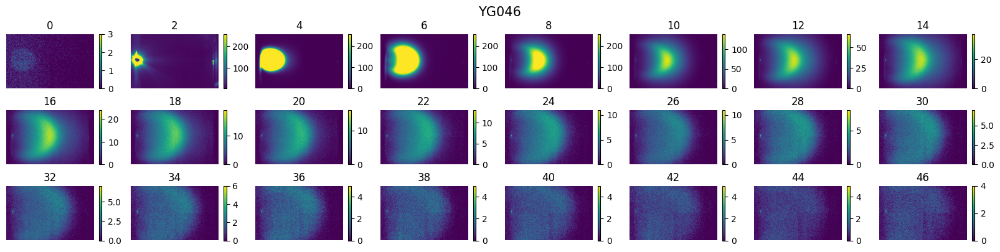

In [ ]:
file = '../../datasets/YG055_YichenGuo_06262024.h5'

plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
keys = plume_ds.dataset_names()
print(keys)

labels = list(np.arange(0, 48, 2))
ds_name = file.split('/')[-1].split('_')[0]
plumes = plume_ds.load_plumes('1-SrRuO3')
show_images(plumes[5][labels], labels=labels, img_per_row=8, img_height=1, title=ds_name, show_colorbar=True)
plt.show()

In [ ]:
frame_view_YG055 = plume_ds.load_plumes('1-SrRuO3_Pre')[1][1]
coords_YG055 = np.array([[17,46], [19,208], [366,39], [364,222]])
px.imshow(frame_view_YG055)

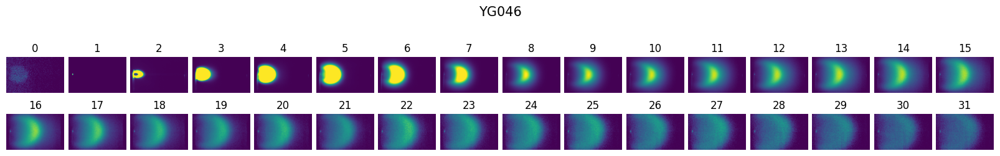

100%|██████████| 125/125 [00:32<00:00,  3.87it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


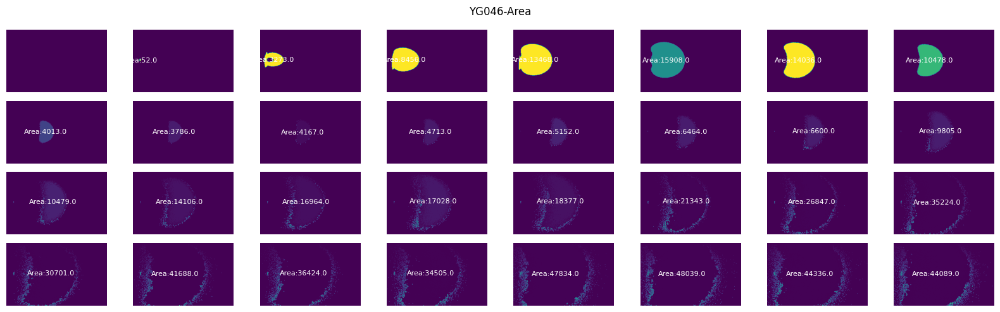

100%|██████████| 125/125 [00:11<00:00, 11.18it/s]


(32, 250, 400) (32, 2) (32,) (32,)


In [ ]:
df_YG055 = analyze_function(P, V, plumes, threshold, index, viz_index, ds_name, align_parms={'align':False, 'coords':coords_YG055, 'coords_standard':coords_YG055})
df_YG055['Growth'] = ds_name
df_YG055.to_csv('../../datasets/SRO_plume_metrics/YG055_metrics.csv')

## YG056

['1-SrRuO3', '1-SrRuO3_Pre']


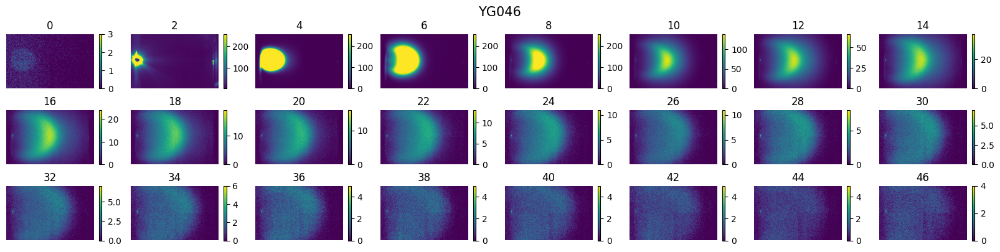

In [ ]:
file = '../../datasets/YG056_YichenGuo_06282024.h5'

plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
keys = plume_ds.dataset_names()
print(keys)

labels = list(np.arange(0, 48, 2))
ds_name = file.split('/')[-1].split('_')[0]
plumes = plume_ds.load_plumes('1-SrRuO3')
show_images(plumes[5][labels], labels=labels, img_per_row=8, img_height=1, title=ds_name, show_colorbar=True)
plt.show()

In [ ]:
frame_view_YG056 = plume_ds.load_plumes('1-SrRuO3_Pre')[1][1]
coords_YG056 = np.array([[27,56], [27,203], [372,39], [374,223]])
px.imshow(frame_view_YG056)

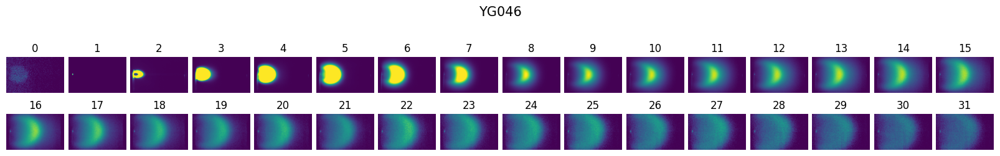

100%|██████████| 125/125 [00:32<00:00,  3.87it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


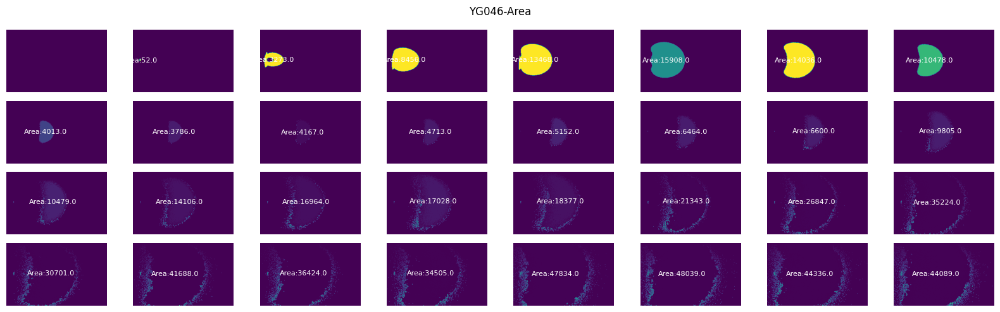

100%|██████████| 125/125 [00:11<00:00, 11.18it/s]


(32, 250, 400) (32, 2) (32,) (32,)


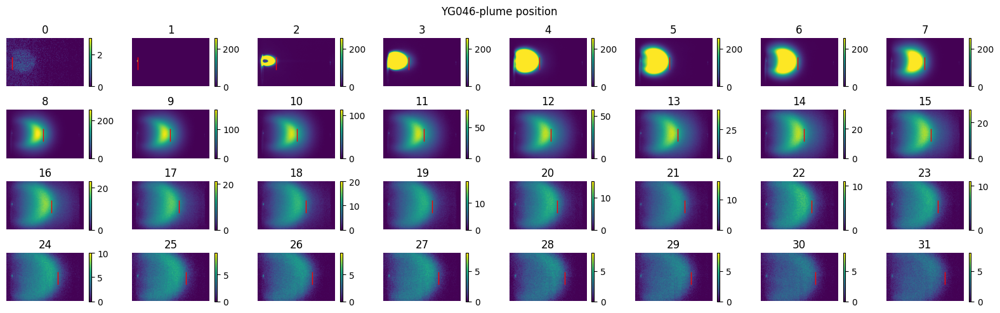

In [ ]:
df_YG046 = analyze_function(P, V, plumes, threshold, index, viz_index, ds_name, align_parms={'align':False, 'coords':coords_YG046, 'coords_standard':coords_YG046})
df_YG046['Growth'] = ds_name
df_YG046.to_csv('../../datasets/SRO_plume_metrics/YG046_metrics.csv')

## YG051

['1-SrRuO3', '1-SrRuO3_Pre']


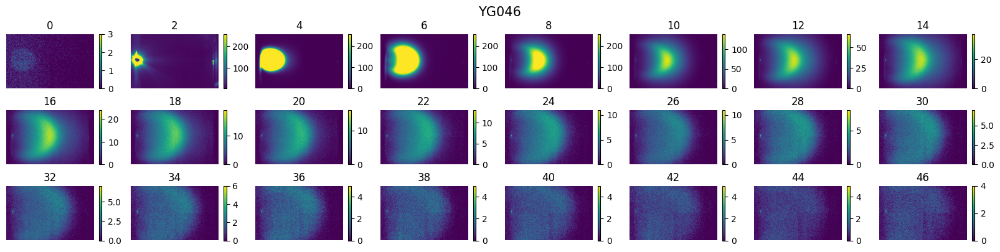

In [ ]:
file = '../../datasets/YG046_YichenGuo_05162024.h5'

plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
keys = plume_ds.dataset_names()
print(keys)

labels = list(np.arange(0, 48, 2))
ds_name = file.split('/')[-1].split('_')[0]
plumes = plume_ds.load_plumes('1-SrRuO3')
show_images(plumes[5][labels], labels=labels, img_per_row=8, img_height=1, title=ds_name, show_colorbar=True)
plt.show()

In [ ]:
frame_view_YG046 = plume_ds.load_plumes('1-SrRuO3_Pre')[1][1]
coords_YG046 = np.array([[27,46], [27,203], [372,39], [374,223]])
px.imshow(frame_view_YG046)

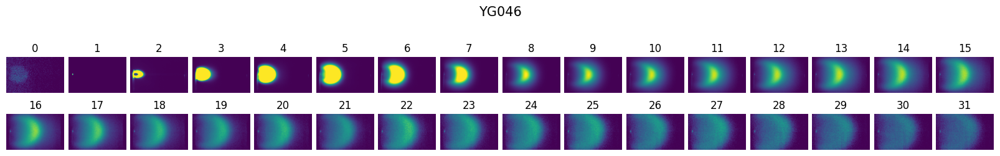

100%|██████████| 125/125 [00:32<00:00,  3.87it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


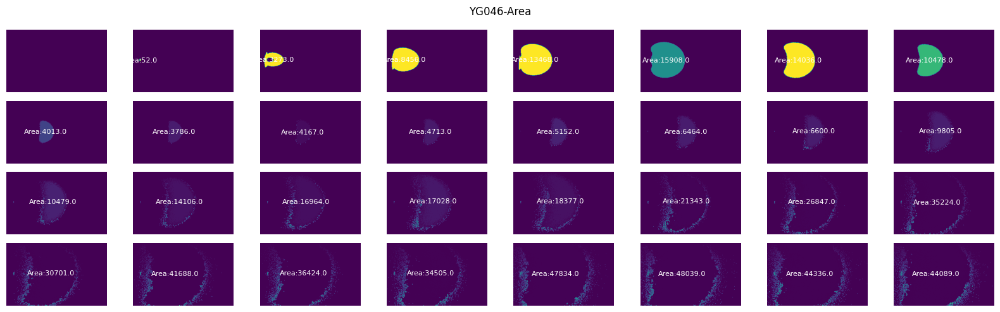

100%|██████████| 125/125 [00:11<00:00, 11.18it/s]


(32, 250, 400) (32, 2) (32,) (32,)


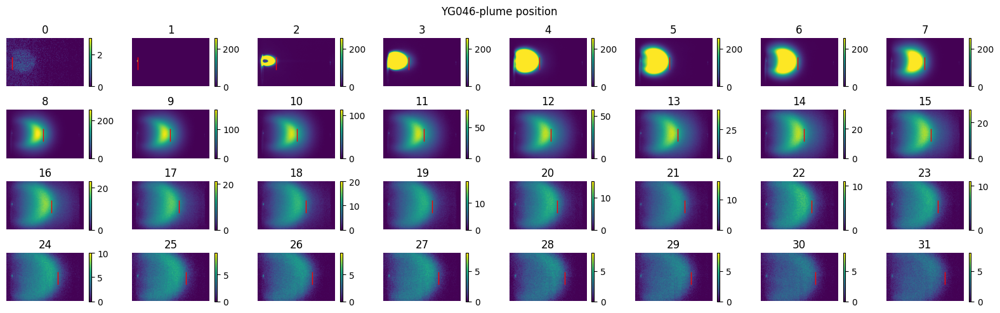

In [ ]:
df_YG046 = analyze_function(P, V, plumes, threshold, index, viz_index, ds_name, align_parms={'align':False, 'coords':coords_YG046, 'coords_standard':coords_YG046})
df_YG046['Growth'] = ds_name
df_YG046.to_csv('../../datasets/SRO_plume_metrics/YG046_metrics.csv')

In [ ]:
files = ['../../datasets/YG045_YichenGuo_JulianGoddy_05092024.h5', '../../datasets/YG046_YichenGuo_05162024.h5', 
        #  '../../datasets/YG047_YichenGuo_05172024.h5', '../../datasets/YG048_YichenGuo_05302024.h5',
        #  '../../datasets/YG049_YichenGuo_06032024.h5', '../../datasets/YG050_YichenGuo_06052024.h5',
         '../../datasets/YG051_YichenGuo_06122024.h5', '../../datasets/YG052_YichenGuo_06142024.h5',
         '../../datasets/YG053_YichenGuo_06172024.h5', '../../datasets/YG054_YichenGuo_06252024.h5', 
         '../../datasets/YG055_YichenGuo_06262024.h5', '../../datasets/YG056_YichenGuo_06282024.h5', 
         '../../datasets/YG057_YichenGuo_06282024.h5', '../../datasets/YG058_YichenGuo_06292024.h5', 
         '../../datasets/YG059_YichenGuo_07012024.h5', '../../datasets/YG060_YichenGuo_07032024.h5',
         '../../datasets/YG061_YichenGuo_07042024.h5']

# files = ['../../datasets/YG061_YichenGuo_07042024.h5']
plume_ds_list = []
plume_list = []
for file in files:
    plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
    keys = plume_ds.dataset_names()
    print(file)
    print(keys)

    labels = list(np.arange(0, 48, 2))
    ds_name = file.split('/')[-1].split('_')[0]
    plumes = plume_ds.load_plumes('1-SrRuO3')
    show_images(plumes[5][labels], labels=labels, img_per_row=8, img_height=1, title=ds_name, show_colorbar=True)
    plt.show()

    plume_ds_list.append(plume_ds)
    plume_list.append(plumes)

In [ ]:
files = ['../../datasets/YG045_YichenGuo_JulianGoddy_05092024.h5', '../../datasets/YG046_YichenGuo_05162024.h5', 
         '../../datasets/YG047_YichenGuo_05172024.h5', '../../datasets/YG048_YichenGuo_05302024.h5',
         '../../datasets/YG049_YichenGuo_06032024.h5', '../../datasets/YG050_YichenGuo_06052024.h5',
         '../../datasets/YG051_YichenGuo_06122024.h5', '../../datasets/YG052_YichenGuo_06142024.h5',
         '../../datasets/YG053_YichenGuo_06172024.h5', '../../datasets/YG054_YichenGuo_06252024.h5', 
         '../../datasets/YG055_YichenGuo_06262024.h5', '../../datasets/YG056_YichenGuo_06282024.h5', 
         '../../datasets/YG057_YichenGuo_06282024.h5', '../../datasets/YG058_YichenGuo_06292024.h5', 
         '../../datasets/YG059_YichenGuo_07012024.h5', '../../datasets/YG060_YichenGuo_07032024.h5', '../../datasets/YG061_YichenGuo_07042024.h5']
plume_ds_list = []
plume_list = []
for file in files:
    print(file)
    plume_ds = plume_dataset(file_path=file, group_name='PLD_Plumes')
    keys = plume_ds.dataset_names()
    plumes = plume_ds.load_plumes('1-SrRuO3')

    plume_ds_list.append(plume_ds)
    plume_list.append(plumes)

../../datasets/YG045_YichenGuo_JulianGoddy_05092024.h5
../../datasets/YG046_YichenGuo_05162024.h5
../../datasets/YG047_YichenGuo_05172024.h5
../../datasets/YG048_YichenGuo_05302024.h5
../../datasets/YG049_YichenGuo_06032024.h5
../../datasets/YG050_YichenGuo_06052024.h5
../../datasets/YG051_YichenGuo_06122024.h5
../../datasets/YG052_YichenGuo_06142024.h5
../../datasets/YG053_YichenGuo_06172024.h5
../../datasets/YG054_YichenGuo_06252024.h5
../../datasets/YG055_YichenGuo_06262024.h5
../../datasets/YG056_YichenGuo_06282024.h5
../../datasets/YG057_YichenGuo_06282024.h5
../../datasets/YG058_YichenGuo_06292024.h5
../../datasets/YG059_YichenGuo_07012024.h5
../../datasets/YG060_YichenGuo_07032024.h5
../../datasets/YG061_YichenGuo_07042024.h5


In [ ]:
plume_ds_YG045, plume_ds_YG046, plume_ds_YG047, plume_ds_YG048, plume_ds_YG049, plume_ds_YG050, plume_ds_YG051, plume_ds_YG052, plume_ds_YG053, plume_ds_YG054, plume_ds_YG055, plumes_ds_YG056, plume_ds_YG057, plume_ds_YG058, plume_ds_YG059, plume_ds_YG060, plumes_ds_YG061 = plume_ds_list
plumes_YG045, plumes_YG046, plumes_YG047, plumes_YG048, plumes_YG049, plumes_YG050, plumes_YG051, plumes_YG052, plumes_YG053, plume_YG054, plume_YG055, plumes_YG056, plume_YG057, plume_YG058, plume_YG059, plume_YG060, plumes_YG061 = plume_list

In [ ]:
print(plumes_YG051.shape)
show_images(plumes_YG051[:, 6], labels=None, img_per_row=10, img_height=1, title=ds_name, show_colorbar=True)
plt.show()

In [ ]:
frame_view_YG046 = plume_ds_YG046.load_plumes('1-SrRuO3_Pre')[1][1]
coords_YG046 = np.array([[27,46], [27,203], [372,39], [374,223]])
px.imshow(frame_view_YG046)

In [ ]:
frame_view_YG047 = plume_ds_YG047.load_plumes('1-SrRuO3_Pre')[0][0]
coords_YG047 = np.array([[36,39], [35,197], [383,34], [382,218]])
px.imshow(frame_view_YG047)

In [ ]:
frame_view_YG048 = plume_ds_YG048.load_plumes('1-SrRuO3_Pre')[1][1]
coords_YG048 = np.array([[30,50], [28,209], [376,45], [375,229]])
px.imshow(frame_view_YG048)

In [ ]:
frame_view_YG049 = plume_ds_YG049.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG049 = np.array([[22,58], [26,215], [374,52], [374,235]])
px.imshow(frame_view_YG049)

In [ ]:
frame_view_YG050 = plume_ds_YG050.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG050 = np.array([[25,54], [28,204], [374,48], [371,232]])
px.imshow(frame_view_YG050)

In [ ]:
frame_view_YG051 = plume_ds_YG051.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG051 = np.array([[15,52], [19,215], [363,38], [362,223]])
px.imshow(frame_view_YG051)

In [ ]:
frame_view_YG052 = plume_ds_YG052.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG052 = np.array([[19,52], [21,215], [396,46], [394,320]])
px.imshow(frame_view_YG052)

In [ ]:
frame_view_YG053 = plume_ds_YG053.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG053 = np.array([[14,50], [16,214], [359,44], [361,229]])
px.imshow(frame_view_YG053)

In [ ]:
frame_view_YG054 = plume_ds_YG054.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG054 = np.array([[14,55], [15,217], [357,48], [360,234]])
px.imshow(frame_view_YG054)

In [ ]:
frame_view_YG055 = plume_ds_YG055.load_plumes('1-SrRuO3_Pre')[1][0]
coords_YG055 = np.array([[17,46], [19,208], [366,39], [364,222]])
px.imshow(frame_view_YG055)

## analyze plumes

### parse df

In [ ]:
# analysis frame parameters
start_position = (30, (51+208)//2) # start position of plume 
position_range = (30, 376) # x position range
threshold = 20
time_interval = 500e-9  # 500ns

# visualize parameters
index = 3
# x_range = (8, 82) # x_range of frames to visualize
viz_index = list(np.arange(0, 32, 1))

P = PlumeMetrics(time_interval, threshold=threshold)
V = VelocityCalculator(time_interval, position_range, start_position, threshold=threshold)

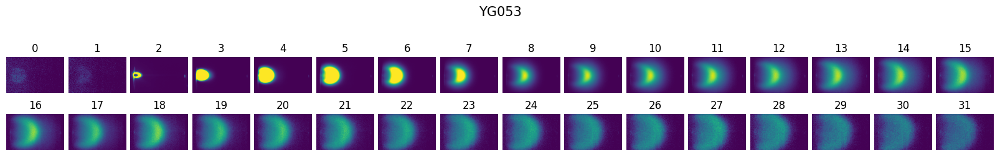

100%|██████████| 156/156 [00:22<00:00,  6.81it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


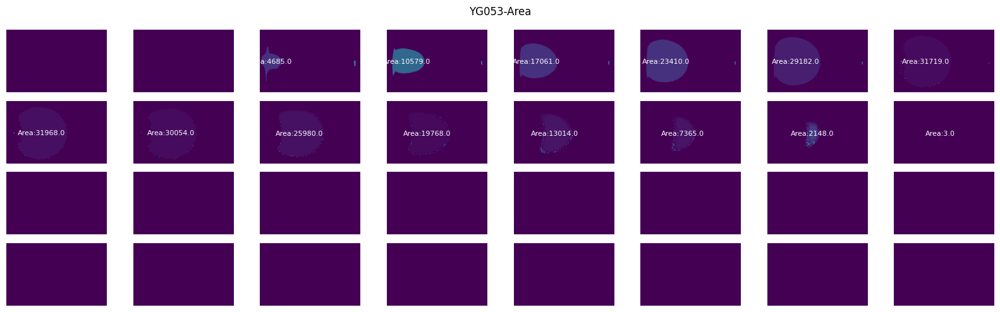

100%|██████████| 156/156 [00:15<00:00, 10.28it/s]


(32, 250, 400) (32, 2) (32,) (32,)


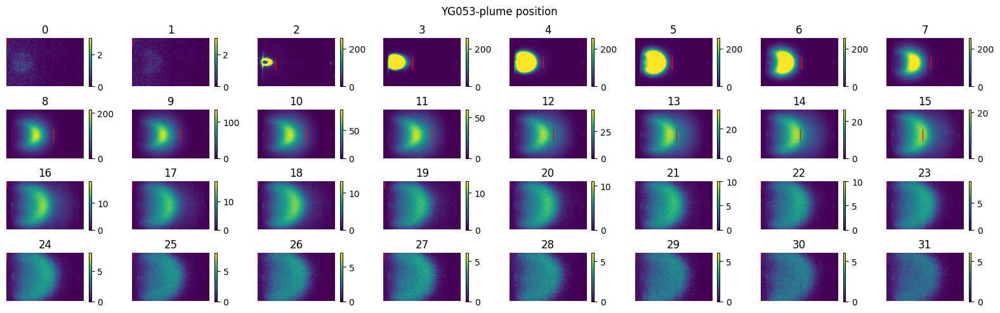

In [ ]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG045 = analyze_function(P, V, plumes_YG045, threshold, index, viz_index, ds_name, align_parms={'align':False, 'coords':coords_YG045, 'coords_standard':coords_YG045})
df_YG045['Growth'] = 'YG045'

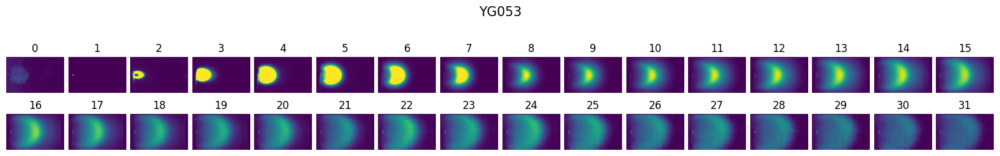

100%|██████████| 125/125 [00:15<00:00,  8.15it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


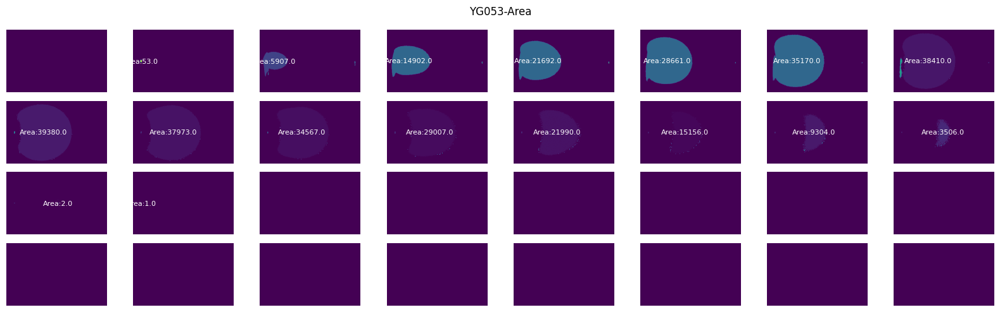

100%|██████████| 125/125 [00:10<00:00, 11.97it/s]


(32, 250, 400) (32, 2) (32,) (32,)


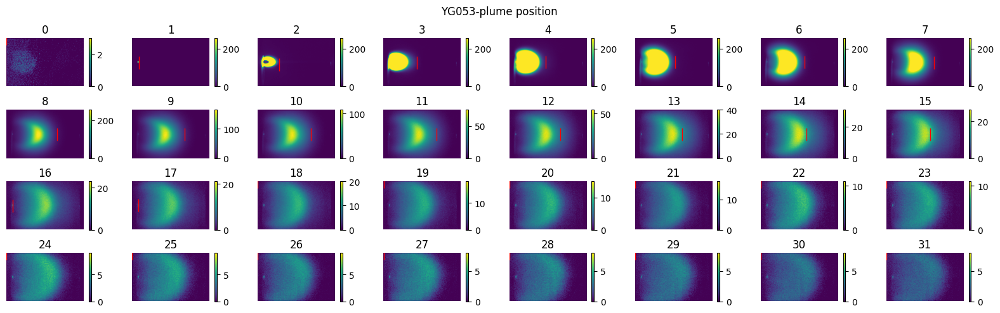

In [ ]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG046 = analyze_function(P, V, plumes_YG046, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG046, 'coords_standard':coords_YG045})
df_YG046['Growth'] = 'YG046'

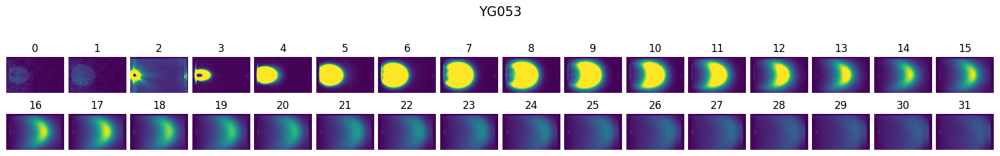

100%|██████████| 94/94 [00:14<00:00,  6.63it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


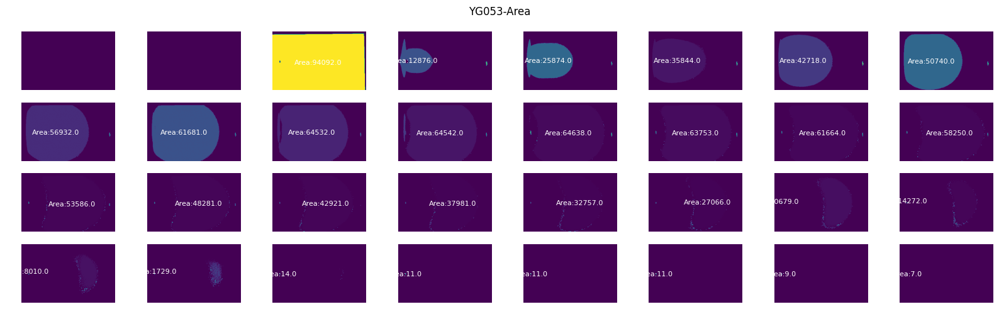

100%|██████████| 94/94 [00:19<00:00,  4.71it/s]


(32, 250, 400) (32, 2) (32,) (32,)


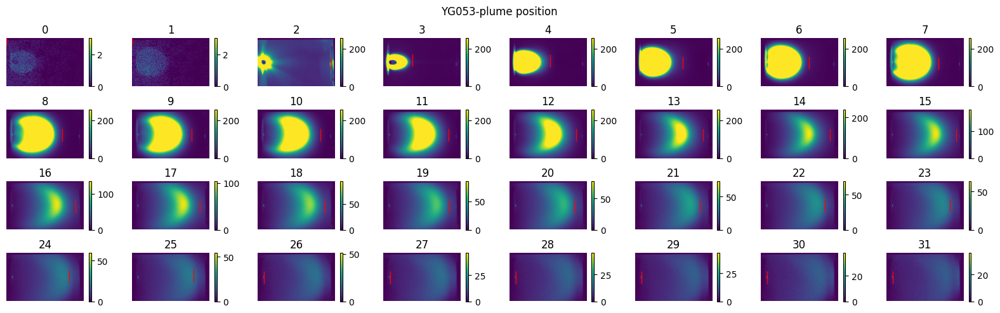

In [ ]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG047 = analyze_function(P, V, plumes_YG047, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG047, 'coords_standard':coords_YG045})
df_YG047['Growth'] = 'YG047'

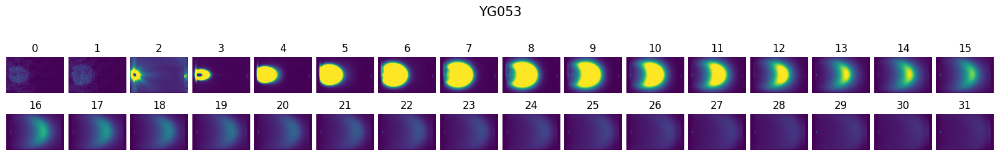

100%|██████████| 189/189 [00:28<00:00,  6.54it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


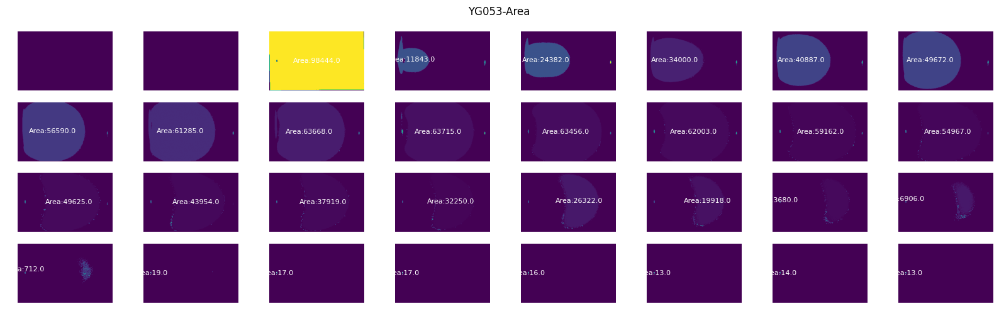

100%|██████████| 189/189 [00:37<00:00,  5.03it/s]


(32, 250, 400) (32, 2) (32,) (32,)


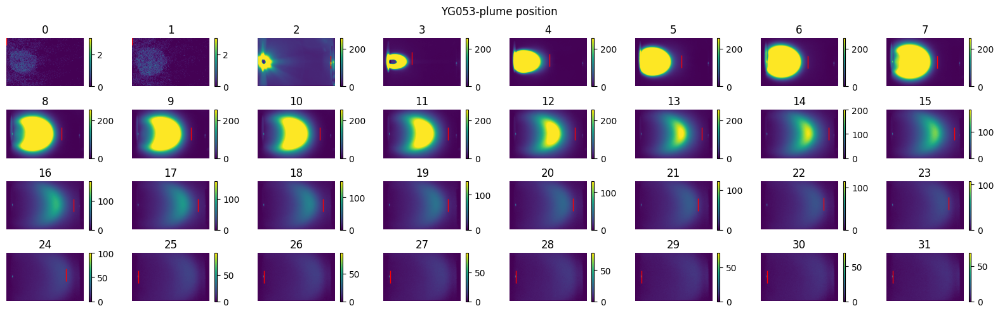

In [ ]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG048 = analyze_function(P, V, plumes_YG048, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG048, 'coords_standard':coords_YG045})
df_YG048['Growth'] = 'YG048'

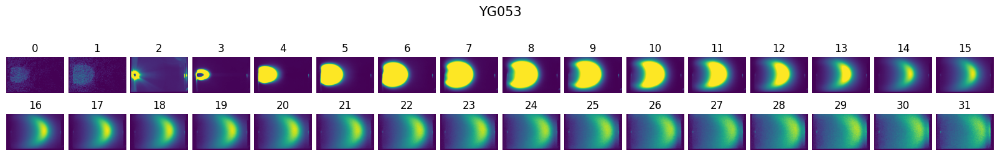

100%|██████████| 459/459 [01:11<00:00,  6.43it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


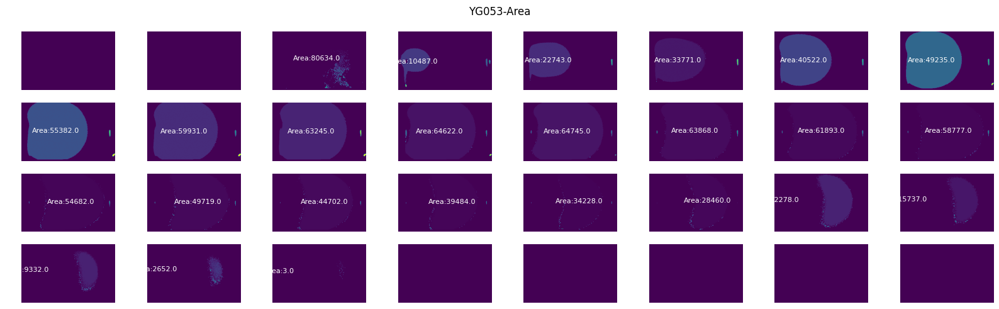

100%|██████████| 459/459 [01:30<00:00,  5.07it/s]


(32, 250, 400) (32, 2) (32,) (32,)


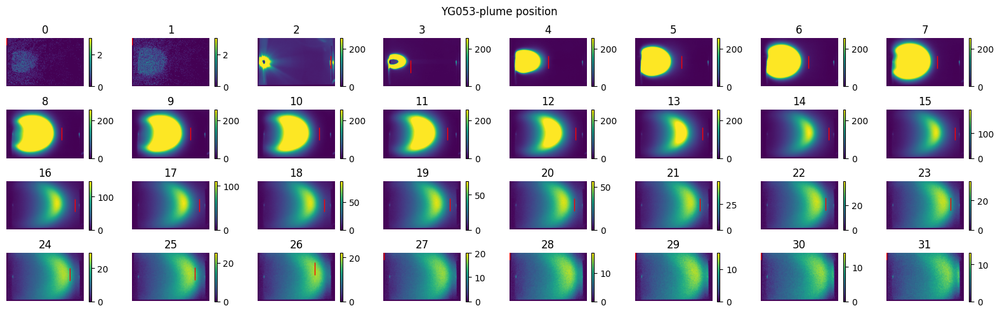

In [ ]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG049 = analyze_function(P, V, plumes_YG049, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG049, 'coords_standard':coords_YG045})
df_YG049['Growth'] = 'YG049'

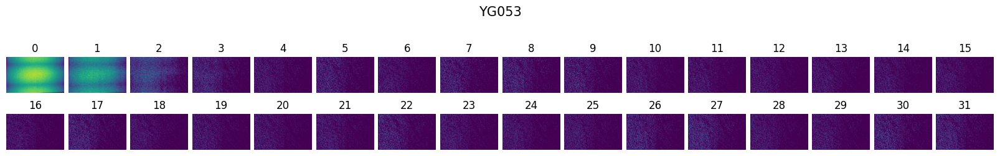

100%|██████████| 189/189 [00:24<00:00,  7.65it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


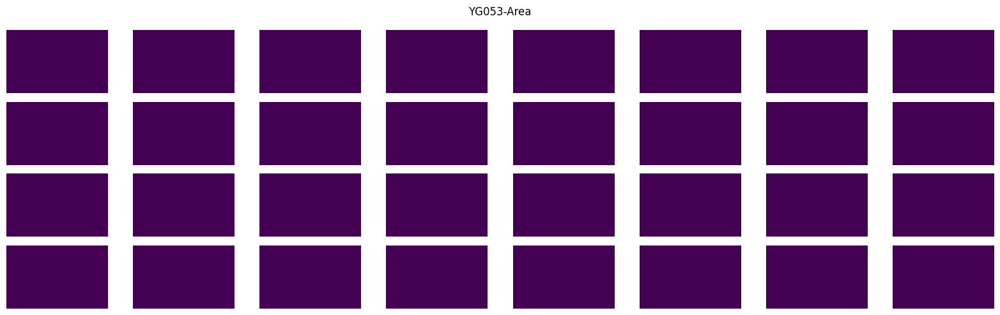

100%|██████████| 189/189 [00:36<00:00,  5.23it/s]


(32, 250, 400) (32, 2) (32,) (32,)


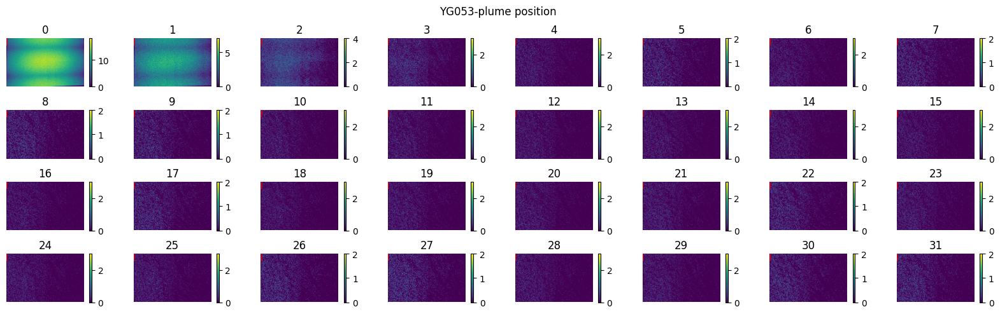

In [ ]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG050 = analyze_function(P, V, plumes_YG050, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG050, 'coords_standard':coords_YG045})
df_YG050['Growth'] = 'YG050'

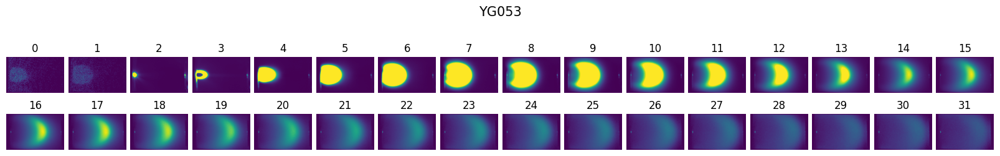

100%|██████████| 189/189 [00:27<00:00,  6.86it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


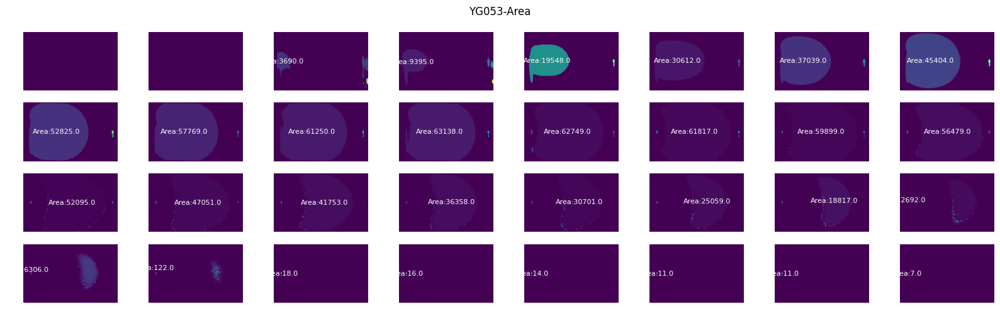

100%|██████████| 189/189 [00:32<00:00,  5.86it/s]


(32, 250, 400) (32, 2) (32,) (32,)


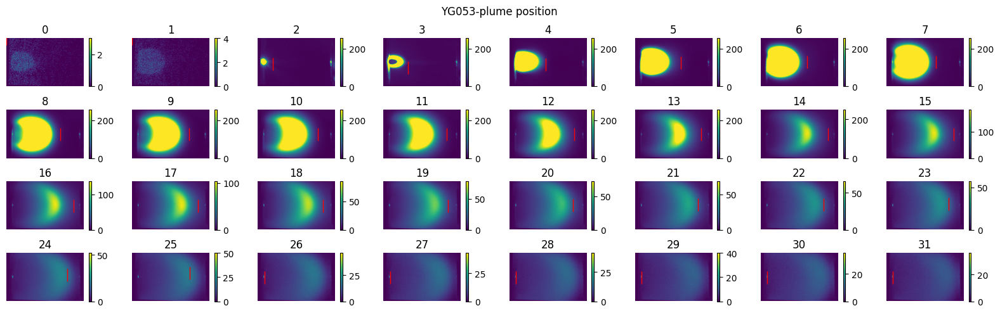

In [ ]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG051 = analyze_function(P, V, plumes_YG051, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG051, 'coords_standard':coords_YG045})
df_YG051['Growth'] = 'YG051'

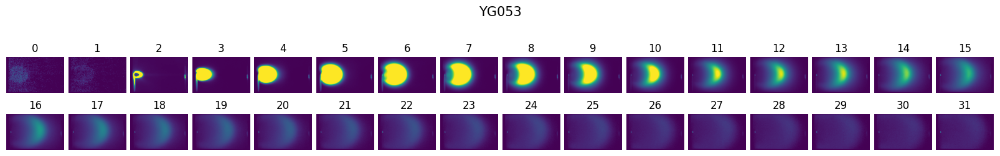

100%|██████████| 219/219 [00:34<00:00,  6.28it/s]


(32, 250, 400) (32,) (32, 2) (32, 250, 400)


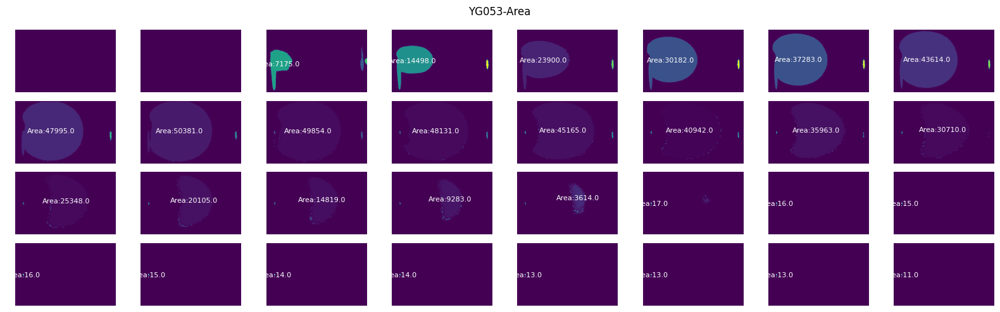

100%|██████████| 219/219 [00:23<00:00,  9.23it/s]


(32, 250, 400) (32, 2) (32,) (32,)


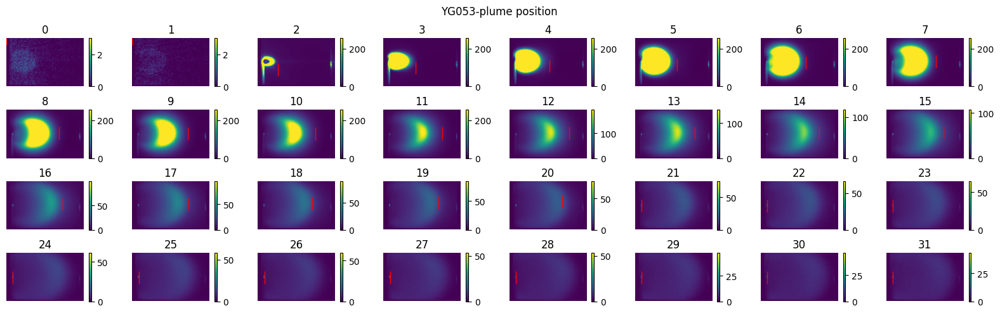

In [ ]:
# show_images(plumes[3][labels], labels=labels, img_per_row=16, img_height=1, title=ds_name)
# plt.show()

df_YG053 = analyze_function(P, V, plumes_YG053, threshold, index, viz_index, ds_name, align_parms={'align':True, 'coords':coords_YG053, 'coords_standard':coords_YG045})
df_YG053['Growth'] = 'YG053'

In [ ]:
df_all = pd.concat([df_YG052, df_YG053, ], axis=0)
df_all

Distance     Velocity     Area Growth
plume_index time_index                                       
0           0                -30          0.0      0.0  YG045
            1                -30          0.0      0.0  YG045
            2                 49  158000000.0   4847.0  YG045
            3                103  108000000.0   9351.0  YG045
            4                143   80000000.0  17138.0  YG045
...                          ...          ...      ...    ...
218         123              -30          0.0      0.0  YG053
            124              -30          0.0      0.0  YG053
            125              -30          0.0      0.0  YG053
            126              -30          0.0      0.0  YG053
            127              -30          0.0      0.0  YG053

[207360 rows x 4 columns]

### plot

In [ ]:
conditions = ['YG045', 'YG046', 'YG047', 'YG048', 'YG049', 'YG050', 'YG051', 'YG053'] 
df_plot = df_all[df_all['Growth'].isin(conditions)]

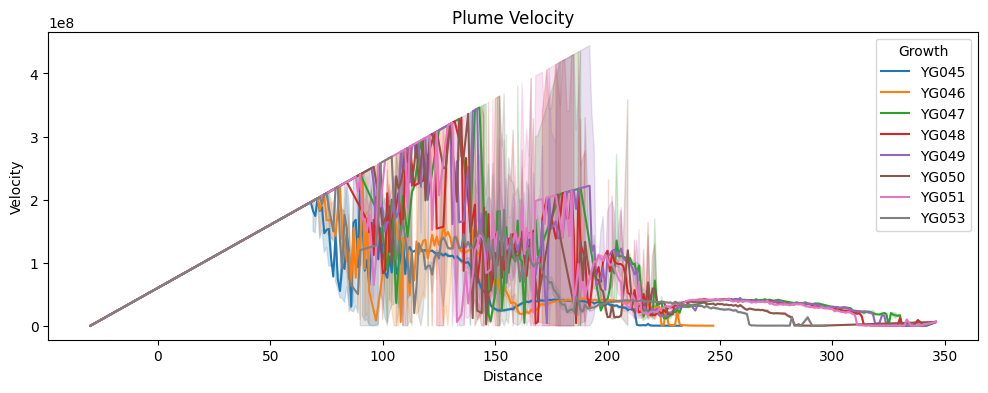

In [ ]:
fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="Distance", y="Velocity", hue="Growth", data=df_plot)
plt.title('Plume Velocity')
plt.show()

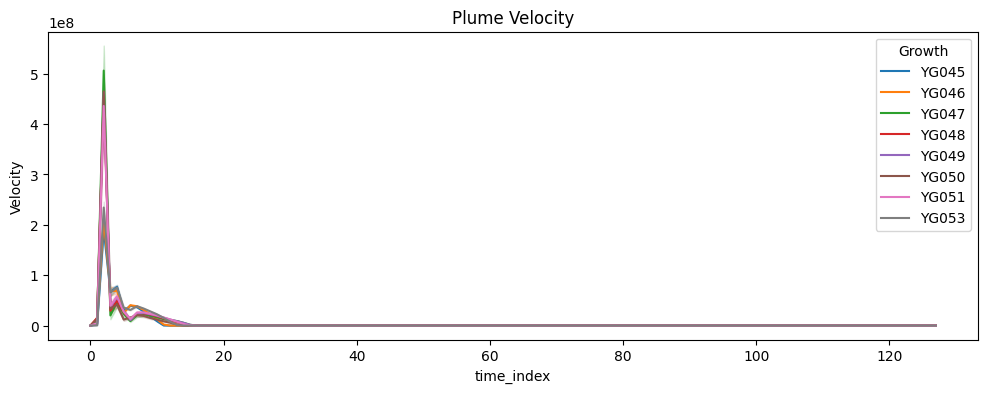

In [ ]:
fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="time_index", y="Velocity", hue="Growth", data=df_plot)
plt.title('Plume Velocity')
plt.show()

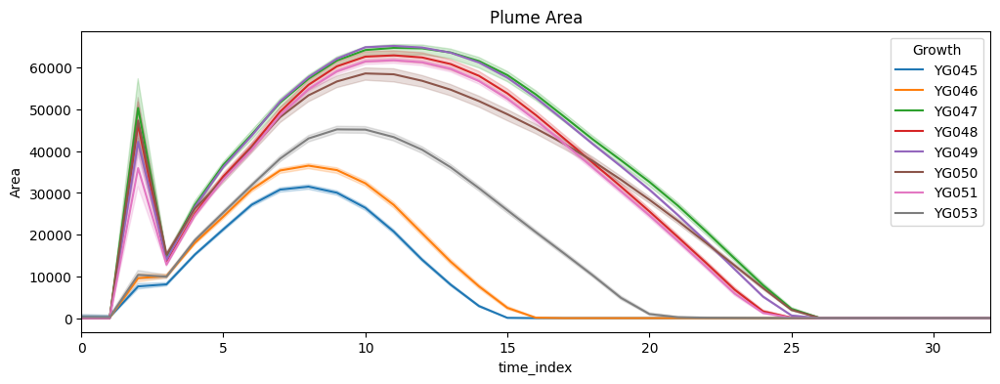

In [ ]:
fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="time_index", y="Area", hue="Growth", data=df_plot)
plt.title('Plume Area')
plt.xlim(0, 32)
plt.show()

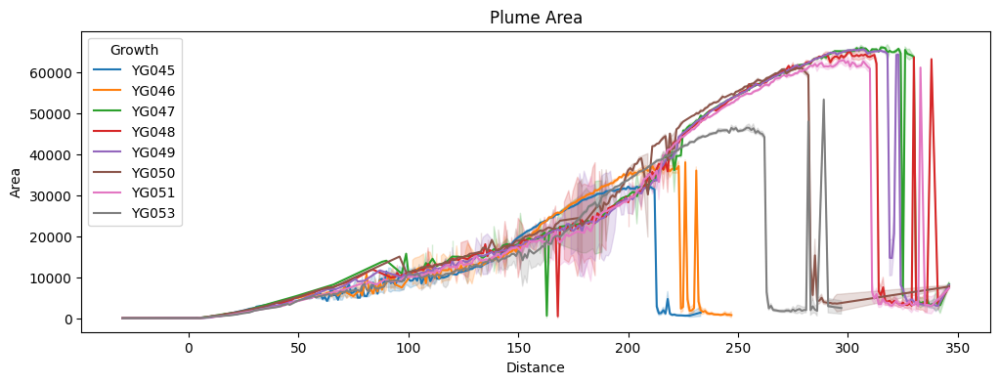

In [ ]:
fig, ax = plt.subplots(figsize=(12, 4))
lineplot = sns.lineplot(x="Distance", y="Area", hue="Growth", data=df_plot)
plt.title('Plume Area')
plt.show()